In [1]:
# Importing all the required libraries
import pandas as pd
import seaborn as sns
import plotly.express as px
from scipy import stats
import matplotlib.pyplot as plt
import numpy as np
import plotly.figure_factory as ff
import plotly.graph_objects as go

In [2]:
# Read the stock data file using pandas
stocks = pd.read_csv("D:\Downloads\Stock\stock (1).csv")
stocks.head()

<>:2: SyntaxWarning: invalid escape sequence '\D'
<>:2: SyntaxWarning: invalid escape sequence '\D'
C:\Users\91976\AppData\Local\Temp\ipykernel_12180\1130692587.py:2: SyntaxWarning: invalid escape sequence '\D'
  stocks = pd.read_csv("D:\Downloads\Stock\stock (1).csv")


,Date,AAPL,BA,T,MGM,AMZN,IBM,TSLA,GOOG,sp500
0,2012-01-12,60.198570,75.510002,30.120001,12.13,175.929993,180.550003,28.250000,313.644379,1295.500000
1,2012-01-13,59.972858,74.599998,30.070000,12.35,178.419998,179.160004,22.790001,311.328064,1289.089966
2,2012-01-17,60.671429,75.239998,30.250000,12.25,181.660004,180.000000,26.600000,313.116364,1293.670044
3,2012-01-18,61.301430,75.059998,30.330000,12.73,189.440002,181.070007,26.809999,315.273285,1308.040039
4,2012-01-19,61.107143,75.559998,30.420000,12.80,194.449997,180.520004,26.760000,318.590851,1314.500000


In [3]:
# Sort the data based on date in order to exactly get the prices in order from past to present
stocks = stocks.sort_values(by = ['Date'])
stocks.head()

,Date,AAPL,BA,T,MGM,AMZN,IBM,TSLA,GOOG,sp500
0,2012-01-12,60.198570,75.510002,30.120001,12.13,175.929993,180.550003,28.250000,313.644379,1295.500000
1,2012-01-13,59.972858,74.599998,30.070000,12.35,178.419998,179.160004,22.790001,311.328064,1289.089966
2,2012-01-17,60.671429,75.239998,30.250000,12.25,181.660004,180.000000,26.600000,313.116364,1293.670044
3,2012-01-18,61.301430,75.059998,30.330000,12.73,189.440002,181.070007,26.809999,315.273285,1308.040039
4,2012-01-19,61.107143,75.559998,30.420000,12.80,194.449997,180.520004,26.760000,318.590851,1314.500000


In [4]:
# Defining the function to normalise the prices wrt initial prices
# Normalising the price based on initial prices means adjusting the prices of assets relative to their initial price at a specific starting point.
# This method is often used to facilitate comparisons across different assets or to analyse the performance of a asset over time relatively.
def norm(df):
    x = df.copy()
    for i in x.columns[1: ]:
        x[i] = x[i]/x[i][0]
    return x

In [5]:
# Defining a function to plot an interactive plot based on the given data
# A line plot will be made by iterating through each column of the data set in order to produce a figure that has plots for each company
# on a single figure.
def interactive_plot(df, title):
  fig = px.line(title = title)
  for i in df.columns[1:]:
    fig.add_scatter(x = df['Date'], y = df[i], name = i)
  fig.show()

In [6]:
# Uisng the above defined function to plot the interactive plot between prices and names of companies.
interactive_plot(stocks, 'Prices')

In [7]:
# Now using the interactive_plot function to get a plot between normalised prices and names of the companies.
interactive_plot(norm(stocks), 'Normalized Prices')

In [8]:
# Definig a function to calculate daily returns
# This will be calculated in the form of % of change in price from the previous day's price. 
def daily_return(df):
    df_daily_return = df.copy()
    # Loop through each column of the dataset making sure that daily returns are calculated for each stock
    for i in df.columns[1:]:
        # Loop through each row belong to a column
        for j in range(1, len(df)):
            # Calculating the % change in price from the previous day's price
            df_daily_return[i][j] = ((df[i][j]- df[i][j-1])/df[i][j-1]) * 100
            # Set the value of the first row to be 0 as previous value is not available
        df_daily_return[i][0] = 0
    return df_daily_return

In [9]:
# Getting the daily returns for every stock
stocks_daily_return = daily_return(stocks)
stocks_daily_return.head()

C:\Users\91976\AppData\Local\Temp\ipykernel_12180\3766349627.py:5: FutureWarning:

ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


C:\Users\91976\AppData\Local\Temp\ipykernel_12180\3766349627.py:5: FutureWarning:

ChainedAssignmentError: behaviour will change

,Date,AAPL,BA,T,MGM,AMZN,IBM,TSLA,GOOG,sp500
0,2012-01-12,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
1,2012-01-13,-0.374946,-1.205144,-0.166006,1.813685,1.415339,-0.769869,-19.327430,-0.738516,-0.494792
2,2012-01-17,1.164812,0.857909,0.598603,-0.809717,1.815943,0.468852,16.717854,0.574410,0.355295
3,2012-01-18,1.038382,-0.239234,0.264463,3.918367,4.282725,0.594448,0.789470,0.688856,1.110793
4,2012-01-19,-0.316937,0.666134,0.296736,0.549882,2.644634,-0.303752,-0.186494,1.052283,0.493866


In [10]:
print(stocks_daily_return.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2159 entries, 0 to 2158
Data columns (total 10 columns):
 #   Column  Non-Null Count  Dtype  
---  ------  --------------  -----  
 0   Date    2159 non-null   object 
 1   AAPL    2159 non-null   float64
 2   BA      2159 non-null   float64
 3   T       2159 non-null   float64
 4   MGM     2159 non-null   float64
 5   AMZN    2159 non-null   float64
 6   IBM     2159 non-null   float64
 7   TSLA    2159 non-null   float64
 8   GOOG    2159 non-null   float64
 9   sp500   2159 non-null   float64
dtypes: float64(9), object(1)
memory usage: 168.8+ KB
None


In [51]:
# S&P 500 average daily return is 0.049%
# Amazon average daily return is 0.15%
# Google average daily return is 0.084%
# Next we will calculate beta for each and every single stock we have in our dataset.

In [11]:
# Select any stock, let's say Apple and the get all the daily returns for it using the above defined function (stocks_daily_return).
stocks_daily_return['AAPL']

0       0.000000
1      -0.374946
2       1.164812
3       1.038382
4      -0.316937
          ...   
2154    0.362467
2155    3.488923
2156   -2.449458
2157    1.453480
2158   -2.973987
Name: AAPL, Length: 2159, dtype: float64

In [12]:
#Now calculate daily returns for the S&P 500 (Market).
stocks_daily_return['sp500'].head()

0    0.000000
1   -0.494792
2    0.355295
3    1.110793
4    0.493866
Name: sp500, dtype: float64

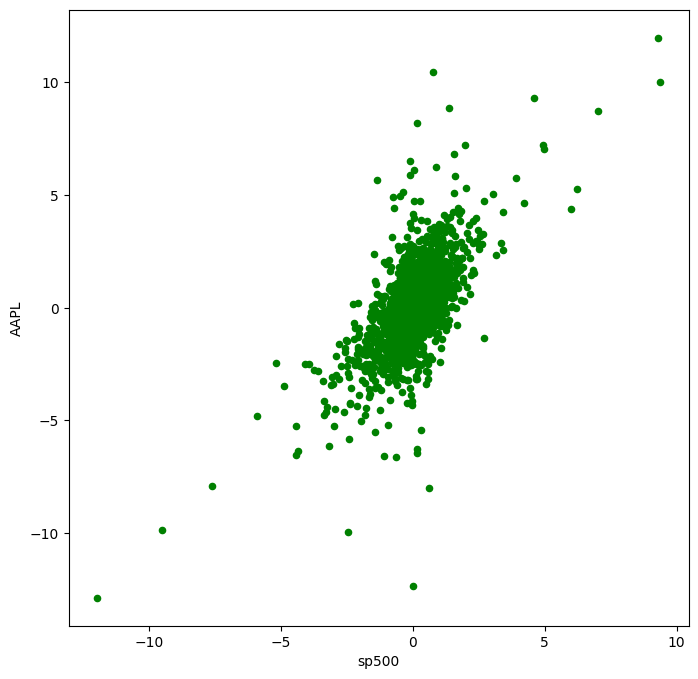

In [13]:
# Plot a scatter plot - selected stock (Apple in this case) and the S&P 500 Index (Market).
# In the following plot we have S&P 500 on the x axis and Apple on the y axis 
# Further, we will use the slope of the regression line on this plot to find out the beta of the stock( basic def of beta).
stocks_daily_return.plot(kind = 'scatter', x = 'sp500', y = 'AAPL',figsize=(8, 8),color='green')
plt.show()

In [14]:
# Fit a ploynomial between selected stock and market index in order to get the regression
# Polynomial fitted with the degree 1 will lead to a linear regression
# beta represents the slope of the regression line (market vs stock daily return)
# Beta is the measure of the volatility or systematic risk of a security or portfolio comapred to the entire market
# Beta is used in CAPM model and describes the relationship between systematic risk and expected return of assets
# Beta = 1 this indicates that the price activity or changes in the price or the daily return of the stock is same as the market index.
# Beta < 1 indicates that the security is theoretically less volatile than the market index ( Ex utility stocks). 
# If the stock is included, this will make the portfolio less risky as compared to the same portfolio without the stock.
# Beta > 1 indicates that the security price is more volatile than the market. For instance, Tesla's beta is 1.26, it means that
# it is 26% more volatile than market
# Tech stocks generally have higher beta than S&P 500 but they also have higher return then.
# Eg MGM is 65% more volatile than market ie S&P 500.
beta, alpha = np.polyfit(stocks_daily_return['sp500'], stocks_daily_return['AAPL'], 1)
print('Beta for {} stock is = {} and alpha is = {}'.format('AAPL', round(beta,3), round(alpha,3)))  
# In this code the beta represents the slope of the regression line and alspha represents the intercept.
# Alpha measures the excess return of an investment relative to the return of the benchmark index.
#  A positive alpha indicates that the investment has performed better than its expected return based on its beta. 
# Conversely, a negative alpha indicates underperformance.
# Positive Alpha: Indicates the investment outperformed the market on a risk-adjusted basis.
# Zero Alpha: Indicates the investment performed in line with the market expectation.
# Negative Alpha: Indicates the investment underperformed the market on a risk-adjusted basis.
# Usage: Alpha is used by investors to assess the performance of portfolio managers or the attractiveness of a stock. 
# It's a crucial part of performance evaluation and is often reported in mutual fund and hedge fund returns.

Beta for AAPL stock is = 1.113 and alpha is = 0.053


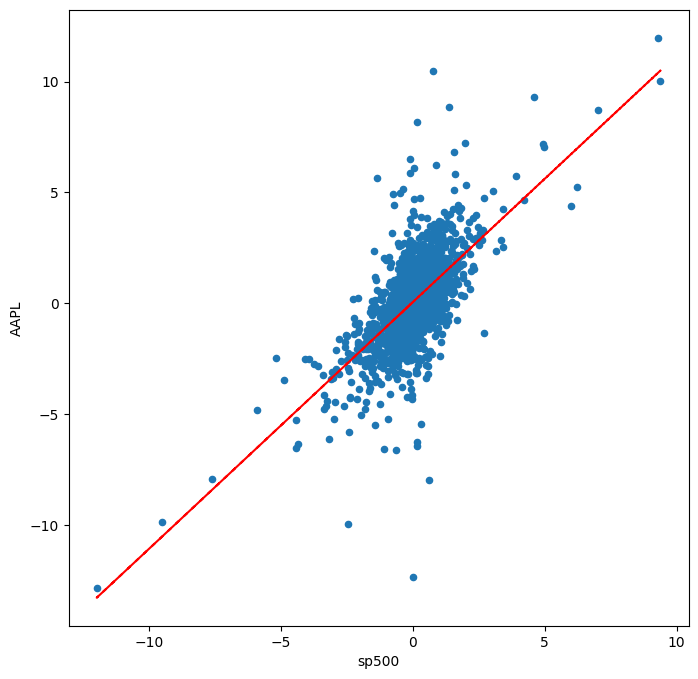

In [15]:
# Now plotting the scatter plot and the regression line in one figure
# First, the code is to plot the scatter plot of market vs apple (S&P 500 on the x axis and apple daily returns on y axis)
stocks_daily_return.plot(kind = 'scatter', x = 'sp500', y = 'AAPL',figsize=(8, 8))
# Secondly, plotting the staright line with the equation y = beta x Rm + alpha
# Rm here is the daily return of the stock
# The plot of the line has S&P 500 on the x axis and the regression values on the y axis 
plt.plot(stocks_daily_return['sp500'], beta * stocks_daily_return['sp500'] + alpha, '--', color = 'r')
plt.show()

In [16]:
# Doing the same for tesla.
beta, alpha = np.polyfit(stocks_daily_return['sp500'], stocks_daily_return['TSLA'], 1)
print('Beta for {} stock is = {} and alpha is = {}'.format('TSLA', round(beta,3), round(alpha,3)))  

Beta for TSLA stock is = 1.269 and alpha is = 0.176


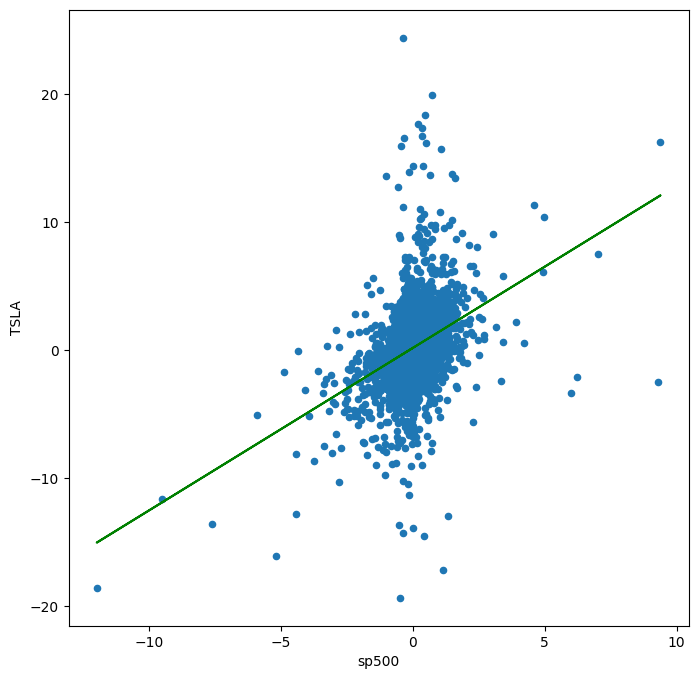

In [17]:
stocks_daily_return.plot(kind = 'scatter', x = 'sp500', y = 'TSLA',figsize=(8, 8))
plt.plot(stocks_daily_return['sp500'], beta * stocks_daily_return['sp500'] + alpha, '-', color = 'g')
plt.show()

In [52]:
# Now we will apply the CAPM formula to the indiviadual stocks in order to get insights on inveting and the possible returns they can produce.

In [18]:
beta

np.float64(1.2686150101095912)

In [19]:
# Calculate the average daily return of the S&P 500 index using the stocks_daily_return function
stocks_daily_return['sp500'].mean()

np.float64(0.04931600660038911)

In [20]:
# Calculate the annual rate of return for S&P 500.
# Stock exchanges are closed for 104 days of an year (saturdays and sundays)
# so average return will be multiplied by 252 for obtaining the annual return
# Note: To annualise any quantity means to obtain a figure that the quantity would have yielded in one year.
rm = round(stocks_daily_return['sp500'].mean() * 252,3)
rm

np.float64(12.428)

In [21]:
# You can assume risk free rate is 0
# Here, assume the yield of a 10 year US govt bond as a risk free rate
rf = 0.66 
# Now calculate the expected return on apple's stock using the CAPM formula
# CAPM : Expected return = risk free rate + beta x market premium
# Market premium is the value that you get over and above the risk free rate 
# that means the differnce between what you got out of your stock and what you would have got if you had invested in bonds
# It is basically the incentive for the investors to invest in risky assets
# That is why the market premium for more risky assets is higher 
# That somehow means the greater rturn the greater the risk
ER_AAPL = round(rf + ( beta * (rm-rf) ) ,3)
ER_AAPL

np.float64(15.589)

In [22]:
# Calculate beta and alpha for AT&T ( American Telephone and Telegraph Company," is a major telecommunications 
# company based in the United States. It is one of the largest providers of mobile telephone services and fixed telephone services 
# in the United States. Additionally, AT&T offers broadband subscription television services through its DirecTV subsidiary and 
# a range of other telecommunications and digital entertainment services.) first
beta, alpha = np.polyfit(stocks_daily_return['sp500'], stocks_daily_return['T'], 1)
print('Beta for {} stock is = {} and alpha is = {}'.format('T', round(beta,3), round(alpha,3)))

Beta for T stock is = 0.745 and alpha is = -0.029


In [23]:
# Calculate the return on AT&T using CAPM formula
ER_T = round(rf + ( beta * (rm - rf) ),3) 
print(ER_T)

9.423


In [24]:
# Do the scatter plots of  daily returns on each stock vs  daily returns on S&P 500 and the regression line plots in one figure
# This time we will do it using a for loop that will iterate through all the columns of the dataset 
# making sure that each and every stock has been covered
# And we will use the plotly express to plot the interactive plots this time
for i in stocks_daily_return.columns:
  
  if i != 'Date' and i != 'sp500':
    fig = px.scatter(stocks_daily_return, x = 'sp500', y = i, title = i)
    # Now we will fit a straight line and obtain the linear regression plot on the same figure
    # line: y = beta x stocks_daily_return + alpha
    b, a = np.polyfit(stocks_daily_return['sp500'], stocks_daily_return[i], 1)
    fig.add_scatter(x = stocks_daily_return['sp500'], y = b*stocks_daily_return['sp500'] + a)
    fig.show()

In [25]:
# View beta for every stock
beta

np.float64(0.744629345474785)

In [26]:
# view alpha for every stock
# Alpha describes the security's ability to beat the market
# Alpha indicates the excess return 
# A positive alpha means portfolio's return exceeds the benchmark market index
# An alpha of 0.175 for Tesla means that the returns of Tesla exceeded the benchmark index by 17.5%.
alpha

np.float64(-0.028563430198461717)

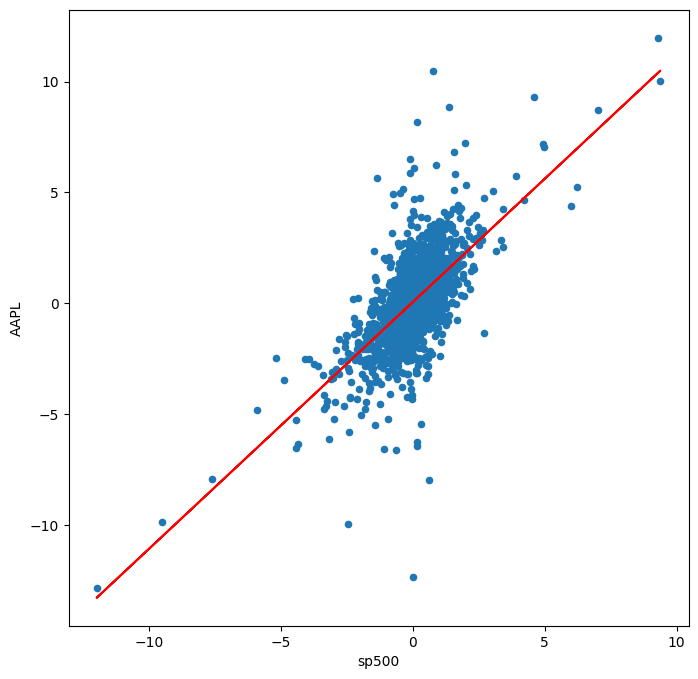

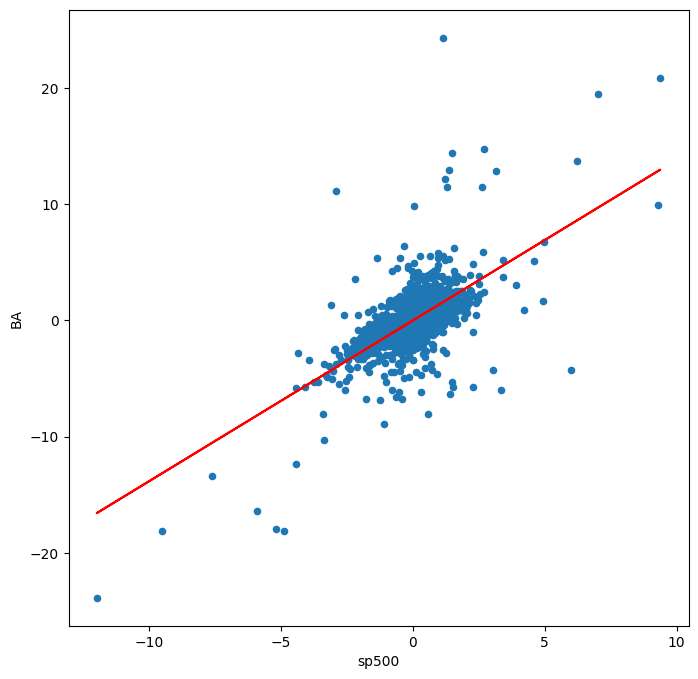

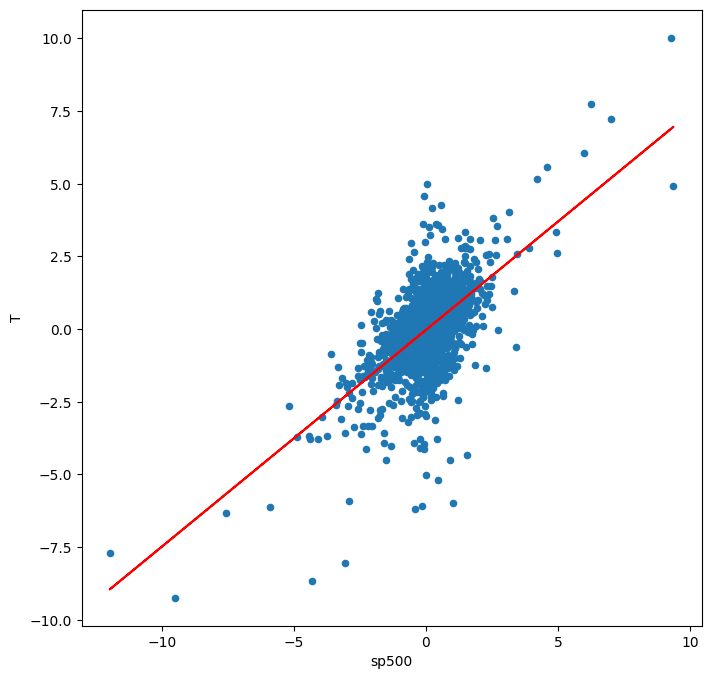

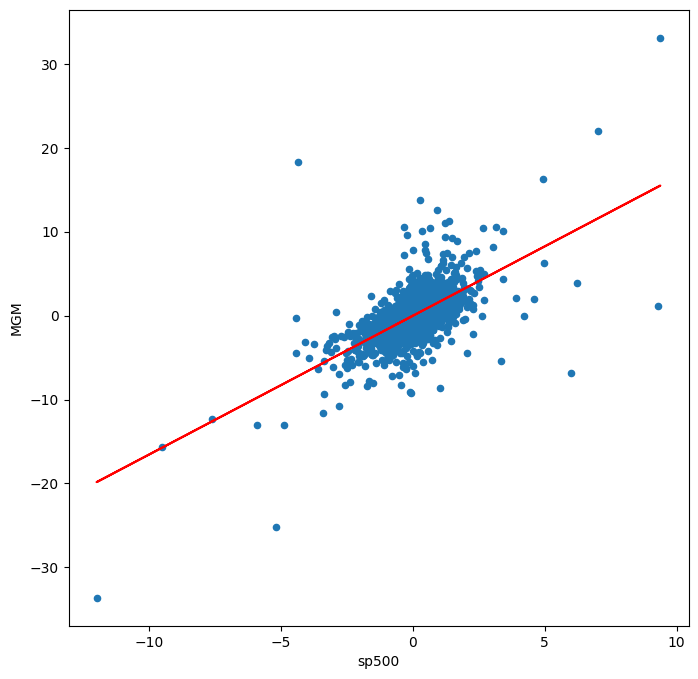

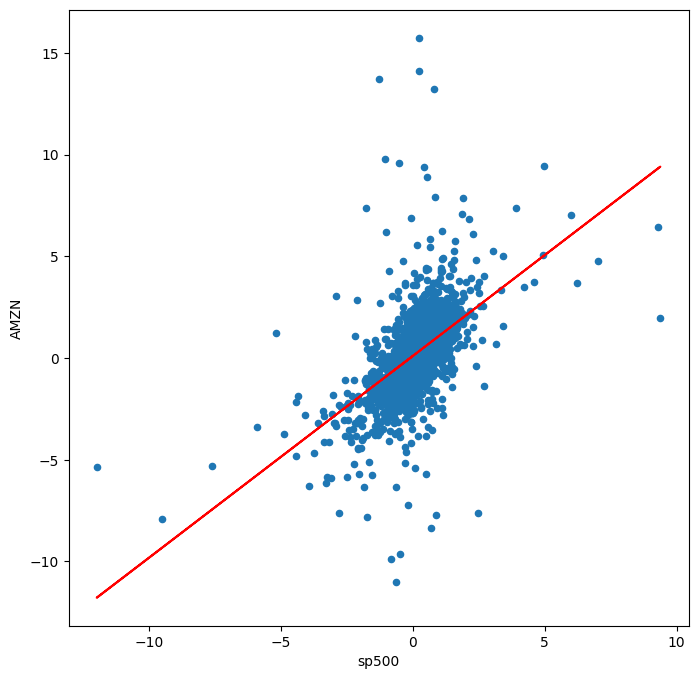

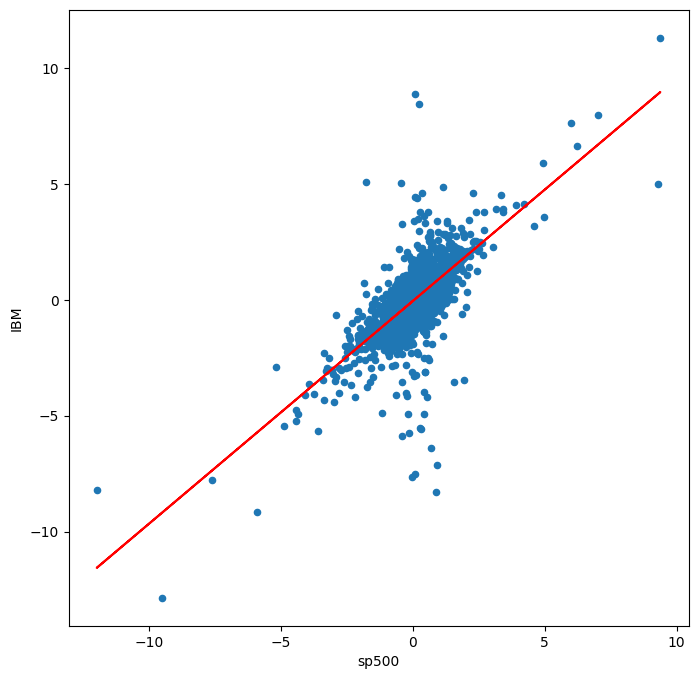

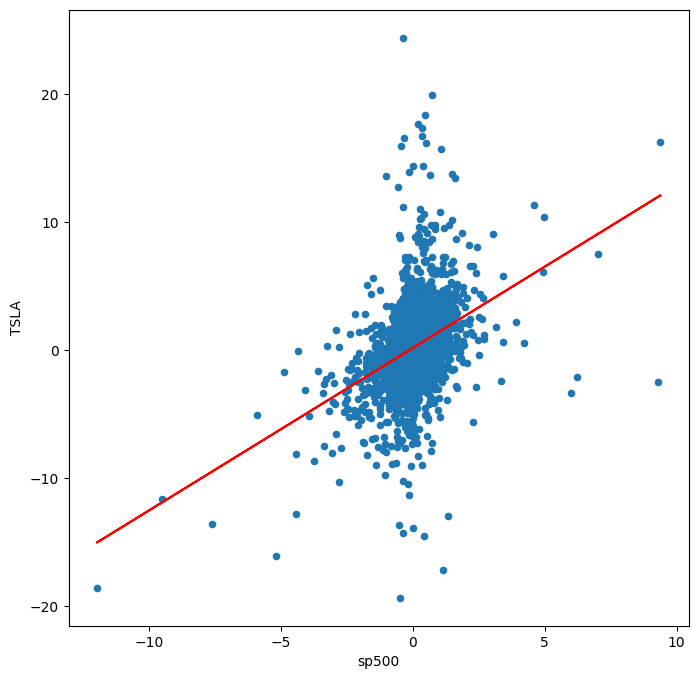

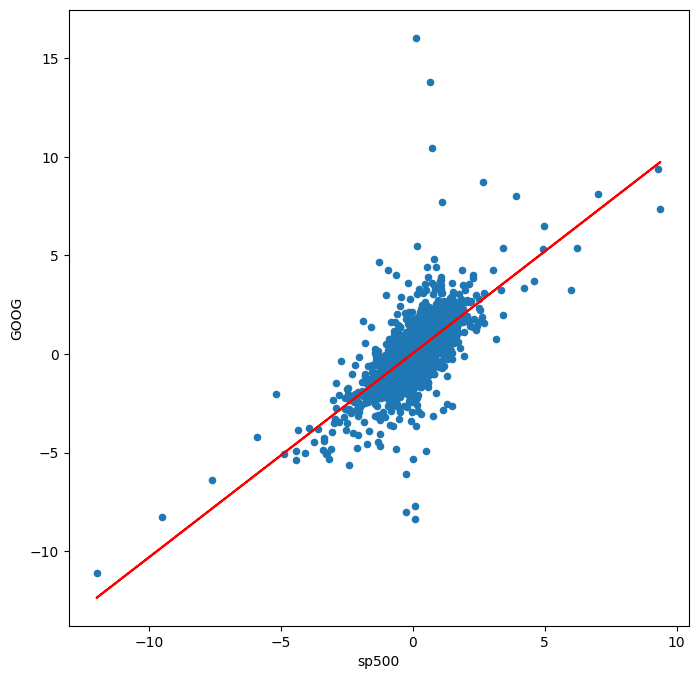

In [27]:
# Create containers for all betas and alphas (empty dictionaries in this case)
beta = {}
alpha = {}
# Loop through every stock daily return
for i in stocks_daily_return.columns:
    # Ignore the date and S&P 500 columns
    if i != 'Date' and i != 'sp500':
        # Plot a scatter plot between each individaul stock and the S&P 500
        stocks_daily_return.plot(kind = 'scatter', x = 'sp500', y = i,figsize=(8, 8))
        # Fit a ploynomial between each stock and market index ( degree = 1) : Linear regression
        b, a = np.polyfit(stocks_daily_return['sp500'], stocks_daily_return[i], 1)
        # Plot the straight line
        plt.plot(stocks_daily_return['sp500'], b * stocks_daily_return['sp500'] + a, '-', color = 'r')
        beta[i] = b
    
    alpha[i] = a
    
    plt.show()

In [28]:
# Obtain a list of all the stock names
keys = list(beta.keys())
keys

['AAPL', 'BA', 'T', 'MGM', 'AMZN', 'IBM', 'TSLA', 'GOOG']

In [29]:
# Create an empty dictionary used to contain the expected returns
ER = {}

rf = 0.66 # This is the risk free rate (10 year US govt bond returns)
rm = round(stocks_daily_return['sp500'].mean() * 252,3) # This is the expected return of the market
rm

np.float64(12.428)

In [30]:
# Calculate return for each security using CAPM.
# We will iterate through the list of all the stock names and will apply the CAPM formula to each of them
for i in keys:
    ER[i] = rf + ( beta[i] * (rm-rf) ) 
    # betas for the stocks are stored in the dictionary  that has keys as all the stock names and we have obtained the stock names in a 
    # list named as keys and we are iterating through the list and also iterating through the dictionary
    # using each value of the list ( beta[i] ; where i represents iteration through the list keys)

In [31]:
# Printing the expected return for each stock.
for i in keys:
  print('Expected Return Based on CAPM for {} is {}%'.format(i, round(ER[i],3)))

Expected Return Based on CAPM for AAPL is 13.757%
Expected Return Based on CAPM for BA is 16.934%
Expected Return Based on CAPM for T is 9.423%
Expected Return Based on CAPM for MGM is 20.119%
Expected Return Based on CAPM for AMZN is 12.331%
Expected Return Based on CAPM for IBM is 11.962%
Expected Return Based on CAPM for TSLA is 15.589%
Expected Return Based on CAPM for GOOG is 12.838%


In [32]:
# Here we will assume that each stock in the portfolio has same weight.
# Portfolio weights are essential in the CAPM model as they determine how the individual asset 
# returns and risks contribute to the overall portfolio. 
# By calculating the weighted sum of the expected returns and betas, investors can 
# evaluate the performance and risk profile of their portfolio.
# portfolio weights refer to the proportions of the total investment allocated to each asset within a portfolio.
portfolio_weights = 1/8 * np.ones(8) 
portfolio_weights

array([0.125, 0.125, 0.125, 0.125, 0.125, 0.125, 0.125, 0.125])

In [33]:
# Calculate the portfolio return
# Foe this we will get all the values of the dictionary Expected returns and convert them to the data type of list
# and then apply sum function onto that list and multiply that with portfolio weights
ER_portfolio_all = round(sum(list(ER.values()) * portfolio_weights),3)
# Here this is o becaus all the stocks have equal weights
# Otherwise we would have obtained the weighted sum of return on each stock in the portfolio to obtain the expected return on portfolio
print('Expected Return Based on CAPM for the portfolio  is {}%\n'.format(ER_portfolio_all))
# If we get the expecyted return on portfolio higher than the expected retrun of market index then 
# it is adviseable to invest in that portfolio

Expected Return Based on CAPM for the portfolio  is 14.119%



In [34]:
# Calculate the expected return on the portfolio withy 50% allocation to each amazon and apple
ER_portfolio = round(0.50 * ER['AAPL'] +  0.50 * ER['AMZN'],3)
print('Expected Return Based on CAPM for the portfolio (50% allocation in Apple and 50% in Amazon) is {}%\n'
      .format(ER_portfolio))

Expected Return Based on CAPM for the portfolio (50% allocation in Apple and 50% in Amazon) is 13.044%



In [35]:
# Consumer services portfolio returns
ER_portfolio_ConsumerServices = round(0.50 * ER['T'] +  0.50 * ER['MGM'],3)
print('Expected Return Based on CAPM for the portfolio (Consumer Services) is {}%\n'
      .format(ER_portfolio_ConsumerServices))

Expected Return Based on CAPM for the portfolio (Consumer Services) is 14.771%



In [36]:
# Mnufacturing sector portfolio returns
ER_portfolio_Manufacturing = round(0.50 * ER['TSLA'] +  0.50 * ER['BA'],3)
print('Expected Return Based on CAPM for the portfolio (Manufacturing Sector) is {}%\n'
      .format(ER_portfolio_Manufacturing))

Expected Return Based on CAPM for the portfolio (Manufacturing Sector) is 16.261%



In [37]:
# Personal devices portfolio returns
ER_portfolio_PersonalDevices = round(0.25 * ER['AAPL'] +  0.25 * ER['IBM']+0.25 * ER['GOOG'] +  0.25 * ER['AMZN'],3)
print('Expected Return Based on CAPM for the portfolio (Personal Devices Sector) is {}%\n'
      .format(ER_portfolio_PersonalDevices))

Expected Return Based on CAPM for the portfolio (Personal Devices Sector) is 12.722%



In [38]:
# below the market return
ER_portfolio_bm = round(0.25 * ER['T'] +  0.25 * ER['IBM']+0.25 * ER['GOOG'] +  0.25 * ER['AMZN'],3)
print('Expected Return Based on CAPM for the portfolio (Less than Market Return) is {}%\n'
      .format(ER_portfolio_bm))

Expected Return Based on CAPM for the portfolio (Less than Market Return) is 11.639%



In [39]:
# above the market returns
ER_portfolio_am = round(0.25 * ER['AAPL'] +  0.25 * ER['BA']+ 0.25 * ER['MGM'] + 0.25 * ER['TSLA'] ,3)
print('Expected Return Based on CAPM for the portfolio (Above than  Market Return) is {}%\n'
      .format(ER_portfolio_am))

Expected Return Based on CAPM for the portfolio (Above than  Market Return) is 16.6%



In [40]:
# Calculating the actual contribution of each stock to the aggregate expected returns
# Contribution of stock i = expected retrun of i / total expected return on the portfolio
# for this we will iterate through all the values of the dictionary made for storing expected returns of each stock
sum=0
for i in keys:
    sum=sum+ER[i] 
for i in keys:
  print('Contribution on CAPM for {} is {}'.format(i, round(ER[i]/sum,2)))

Contribution on CAPM for AAPL is 0.12
Contribution on CAPM for BA is 0.15
Contribution on CAPM for T is 0.08
Contribution on CAPM for MGM is 0.18
Contribution on CAPM for AMZN is 0.11
Contribution on CAPM for IBM is 0.11
Contribution on CAPM for TSLA is 0.14
Contribution on CAPM for GOOG is 0.11


In [41]:
# Expected return on the portfolio having balanced weightage ie the weightage given to each stock is its actual contribution 
# to returns on the portfolio
# and not the equal weightage as assumed earlier
ER_portfolio_b = round(.12 * ER['AAPL'] +  .15 * ER['BA']+ 0.08 * ER['T'] + .18 * ER['MGM']+ 
                     0.11 * ER['AMZN'] +  .11 * ER['IBM']+ .14* ER['TSLA'] + .11* ER['GOOG'],3)
print('Expected Return Based on CAPM for the portfolio (Balanced Weightage) is {}%\n'
      .format(ER_portfolio_b))

Expected Return Based on CAPM for the portfolio (Balanced Weightage) is 14.833%



In [42]:
# high performing stocks portfolio
ER_portfolio_hp = round(0.33 * ER['TSLA'] +  0.33 * ER['BA']+ 0.34 * ER['MGM'] ,3)
print('Expected Return Based on CAPM for the portfolio (High performing) is {}%\n'
      .format(ER_portfolio_hp))

Expected Return Based on CAPM for the portfolio (High performing) is 17.573%



In [43]:
# Low performing stocks portfolio
ER_portfolio_lp = round(0.33 * ER['T'] +  0.33 * ER['GOOG']+0.34 * ER['IBM'],3)
print('Expected Return Based on CAPM for the portfolio (Weak performing) is {}%\n'
      .format(ER_portfolio_lp))

Expected Return Based on CAPM for the portfolio (Weak performing) is 11.413%



In [44]:
# Average performing stocks portfolio
ER_portfolio_ap = round(ER['AAPL'] ,3)
print('Expected Return Based on CAPM for the portfolio (Average performing) is {}%\n'
      .format(ER_portfolio_ap))

Expected Return Based on CAPM for the portfolio (Average performing) is 13.757%



In [45]:
ER_portfolio_ed = round(0.50 * ER['T'] +  0.50 * ER['MGM'],3)
print('Expected Return Based on CAPM for the portfolio (Extremes) is {}%\n'
      .format(ER_portfolio_ed))

Expected Return Based on CAPM for the portfolio (Extremes) is 14.771%



In [46]:
ER_portfolio_ed = round(0.50 * ER['GOOG'] +  0.50 * ER['AAPL'],3)
print('Expected Return Based on CAPM for the portfolio (Median) is {}%\n'
      .format(ER_portfolio_ed))

Expected Return Based on CAPM for the portfolio (Median) is 13.298%



In [47]:
# Oragnising all the expected returns calculated till now in a tabular form
# and sorting them by their expected returns to know which are most rewarding ones
data = {'Combinations':['AAPL', 'BA', 'T', 'MGM','AMZN','IBM','TSLA','GOOG','Equal Portfolio Weights',
                        'AAPL+AMZN','Consumer Services','Manufacturing Sector','Personal Devices Sector',
                        'Less than Market Return','Above than  Market Return','Balanced Weightage',
                        'High performing','Weak performing','Average performing','Extremes','Median'], 
        'Expected Return Based on CAPM':[13.757,16.934, 9.423, 20.119,12.331,11.962,15.589,12.838,14.119,
                                         13.044,14.771,16.261,12.722,11.639,16.6,14.833,17.573,11.413,
                                         13.757,14.771,13.298]} 
Returns = pd.DataFrame(data)
Returns.sort_values(by='Expected Return Based on CAPM', ascending=False,inplace=True)
Returns

,Combinations,Expected Return Based on CAPM
3,MGM,20.119
16,High performing,17.573
1,BA,16.934
14,Above than Market Return,16.600
11,Manufacturing Sector,16.261
6,TSLA,15.589
15,Balanced Weightage,14.833
10,Consumer Services,14.771
19,Extremes,14.771
8,Equal Portfolio Weights,14.119


In [48]:
print("Top 5 Suggested Portfolio") 
Returns[:5]

Top 5 Suggested Portfolio


,Combinations,Expected Return Based on CAPM
3,MGM,20.119
16,High performing,17.573
1,BA,16.934
14,Above than Market Return,16.600
11,Manufacturing Sector,16.261


In [49]:
print("Bottom 5 Suggested Portfolio") 
Returns.tail()

Bottom 5 Suggested Portfolio


,Combinations,Expected Return Based on CAPM
4,AMZN,12.331
5,IBM,11.962
13,Less than Market Return,11.639
17,Weak performing,11.413
2,T,9.423


In [53]:
# Calculating the excess stock return ie expected returns - risk free rate for each stock
excess_stock_return = {}
for i in keys:
    excess_stock_return[i] = ER[i] - rf
print (excess_stock_return)


{'AAPL': np.float64(13.096517938164393), 'BA': np.float64(16.273581222418635), 'T': np.float64(8.76279813754727), 'MGM': np.float64(19.459184770303974), 'AMZN': np.float64(11.67073243456044), 'IBM': np.float64(11.302162717478494), 'TSLA': np.float64(14.92906143896967), 'GOOG': np.float64(12.178488654565937)}


In [56]:
# Converting the data type of excess stock returns into list.
excess_stock_returns = list([excess_stock_return.values()])
print(excess_stock_returns)

[dict_values([np.float64(13.096517938164393), np.float64(16.273581222418635), np.float64(8.76279813754727), np.float64(19.459184770303974), np.float64(11.67073243456044), np.float64(11.302162717478494), np.float64(14.92906143896967), np.float64(12.178488654565937)])]


In [66]:
# Writing down values of excess stock returns in the form of an array and then calculating its standard deviation.
array = ([ 13.09, 16.27, 8.76, 19.45, 11.67, 11.30, 14.92, 12.17])
array_std = np.std(array)
print(array_std)

3.1158503554407098


In [68]:
# calculates the Value-at-Risk (VaR) at a 95% confidence level.
# scipy.stats is a module in SciPy library that contains a large number of probability distributions and statistical functions.
# confidence_level = 0.95 specifies the confidence level for VaR calculation. In this case, it is 95%.
# stats.norm.ppf(1 - confidence_level) computes the z-score corresponding to the left tail of the normal distribution at 1 - confidence_level (i.e., 5%).
#  stats.norm.ppf is the percent point function (inverse of cdf - cumulative distribution function) for a normal distribution.
#  For a 95% confidence level, the left tail probability is 5%, hence 1 - 0.95 = 0.05.
#  The z-score at the 5% level (one-tailed) is approximately -1.645. This represents the number of standard deviations from the mean.
# 1. Set the confidence level: The code sets the confidence level for VaR calculation to 95%.
# 2. Calculate the z-score: It calculates the z-score corresponding to the 5% left tail of the normal distribution, which is approximately -1.645.
# 3. Compute VaR: It multiplies the z-score by the standard deviation of excess stock returns to convert it into a dollar amount.
# 4. Output the VaR: Finally, it prints the calculated VaR value.
import scipy.stats as stats
confidence_level = 0.95
z_score = stats.norm.ppf(1-confidence_level)
VaR = -z_score*array_std*np.sqrt(1)
print(f'Value at Risk (VaR) at {confidence_level*100} % confidence level : {VaR}')

Value at Risk (VaR) at 95.0 % confidence level : 5.125117758184685


In [69]:
# The Sharpe ratio is a measure used in finance to evaluate the risk-adjusted return of an investment portfolio or individual asset.
# The Sharpe ratio helps investors understand the return of an investment compared to its risk.
#  A higher Sharpe ratio indicates that the investment has a better risk-adjusted return.
# Positive Sharpe Ratio: A positive Sharpe ratio indicates that the portfolio's or asset's return exceeds the risk-free rate, 
# adjusted for the risk taken. The higher the ratio, the more attractive the risk-adjusted return.
# Negative Sharpe Ratio: A negative Sharpe ratio indicates that the portfolio's or asset's return is 
# less than the risk-free rate or that the return is negative when adjusted for risk. This suggests poor performance 
# relative to the risk-free rate.
# Zero Sharpe Ratio: A Sharpe ratio close to zero indicates that the portfolio's return is roughly equal to the risk-free rate
#  when adjusted for risk.
def sharpe_ratio(returns, risk_free_rate):
    excess_returns = returns.mean()-risk_free_rate
    return excess_returns/returns.std()
sharpe_ratio_AAPL = sharpe_ratio(stocks_daily_return['AAPL'], rf)
print(f"Sharpe Ratio for AAPL: {sharpe_ratio_AAPL}")


Sharpe Ratio for AAPL: -0.3110229527401566


In [70]:
sharpe_ratio_BA = sharpe_ratio(stocks_daily_return['BA'], rf)
print(f"Sharpe Ratio for BA: {sharpe_ratio_BA}")

Sharpe Ratio for BA: -0.2628943376305143


In [71]:
sharpe_ratio_T = sharpe_ratio(stocks_daily_return['T'], rf)
print(f"Sharpe Ratio for T: {sharpe_ratio_T}")

Sharpe Ratio for T: -0.5153498488025031


In [72]:
sharpe_ratio_MGM = sharpe_ratio(stocks_daily_return['MGM'], rf)
print(f"Sharpe Ratio for MGM: {sharpe_ratio_MGM}")

Sharpe Ratio for MGM: -0.21675530141357777


In [73]:
sharpe_ratio_AMZN = sharpe_ratio(stocks_daily_return['AMZN'], rf)
print(f"Sharpe Ratio for AMZN: {sharpe_ratio_AMZN}")

Sharpe Ratio for AMZN: -0.26396575469589884


In [74]:
sharpe_ratio_IBM = sharpe_ratio(stocks_daily_return['IBM'], rf)
print(f"Sharpe Ratio for IBM: {sharpe_ratio_IBM}")

Sharpe Ratio for IBM: -0.4654753062474767


In [75]:
sharpe_ratio_TSLA = sharpe_ratio(stocks_daily_return['TSLA'], rf)
print(f"Sharpe Ratio for IBM: {sharpe_ratio_TSLA}")

Sharpe Ratio for IBM: -0.12291513216608024
